nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 8.

## Word2vec
 * Concept
 * Code Review

### Concept

 * one hot encoding 시 vector size가 매우 크고 sparse 하므로 neural net 성능이 잘 나오지 않는다.
 * "주위 단어가 비슷하면 해당 단어의 의미는 유사하다" 라는 아이디어
 * 단어를 트레이닝 시킬 때 주위 단어를 label로 매치하여 최적화
 * 단어를 "의미를 내포한 dense vector"로 매칭 시키는 것이 목표!

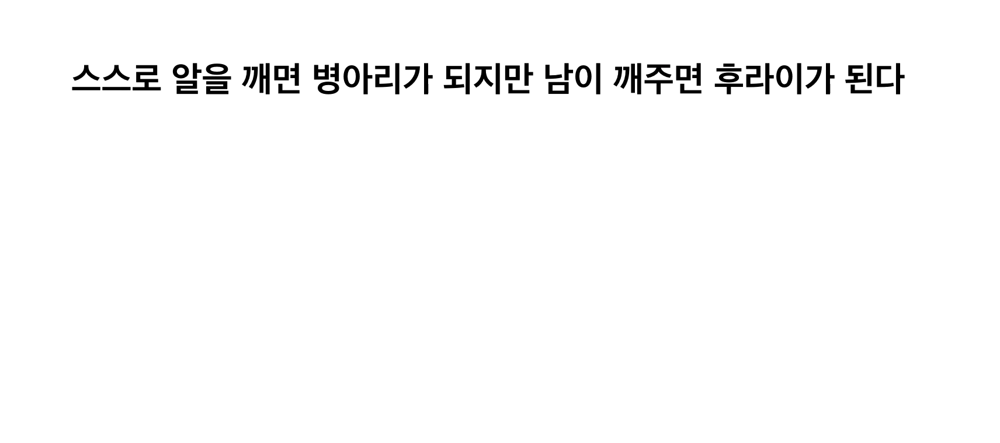

In [2]:
Image('./day8/skip_gram.gif.png')

#### embeddings 

 * dataset으로 구성된 words를 Multi-layer perceptron을 이용하여 학습
 * input layer의 weight에 해당하는 Matrix가 학습이 완료되면 embeddings(vector dictionary) 완성

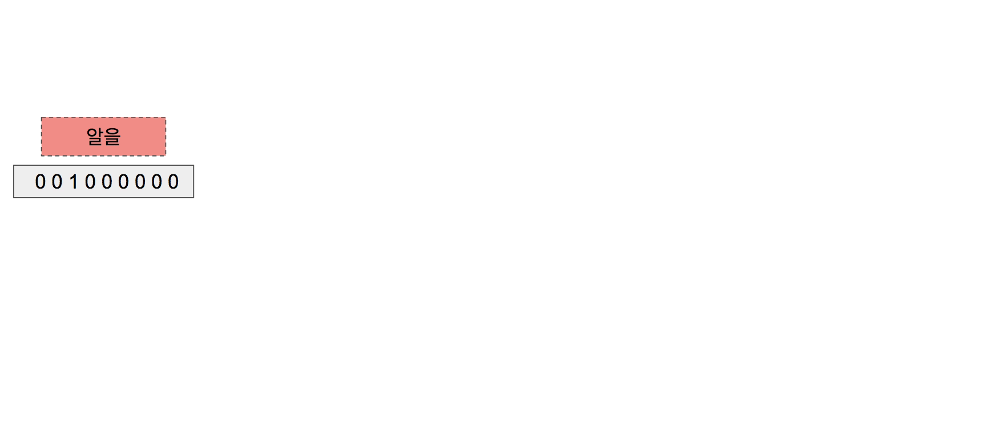

In [3]:
Image('./day8/word_embedding.gif.png')

### Code review

source: https://github.com/tensorflow/tensorflow/blob/r1.3/tensorflow/examples/tutorials/word2vec/word2vec_basic.py

In [ ]:
 embeddings = tf.Variable(
        tf.random_uniform([vocabulary_size, embedding_size], -1.0, 1.0))
    embed = tf.nn.embedding_lookup(embeddings, train_inputs)

    # Construct the variables for the NCE loss
    nce_weights = tf.Variable(
        tf.truncated_normal([vocabulary_size, embedding_size],
                            stddev=1.0 / math.sqrt(embedding_size)))
    nce_biases = tf.Variable(tf.zeros([vocabulary_size]))

  # Compute the average NCE loss for the batch.
  # tf.nce_loss automatically draws a new sample of the negative labels each
  # time we evaluate the loss.
  loss = tf.reduce_mean(
      tf.nn.nce_loss(weights=nce_weights,
                     biases=nce_biases,
                     labels=train_labels,
                     inputs=embed,
                     num_sampled=num_sampled,
                     num_classes=vocabulary_size))

  # Construct the SGD optimizer using a learning rate of 1.0.
  optimizer = tf.train.GradientDescentOptimizer(1.0).minimize(loss)

### GAN
 * Concept
 * Code Review

### Concept

 * 실제 이미지를 보여주고 그 이미지를 "생성해내는" Neural Network를 학습시켜보자
 * 경찰과 위조지폐범 비유로 설명
 * Generator와 Discriminator 역할을 하는 두 Neural Network를 이용
 * 이미지 합성 기술 등에 활용

#### Discriminator

 * fake image와 real image를 분류하는 Neural Network
 * fake image는 label=0으로, real image는 label=1로 학습
 * fake image와 real image를 정확하게 구분 할 수 있는 능력이 갖춰지는 방향으로 학습
 * 만약 fake image가 real image 와 구분 할 수 없을 정도로 같아진다면 discriminator 구분 능력 한계 $\rightarrow$ GAN 학습 완료

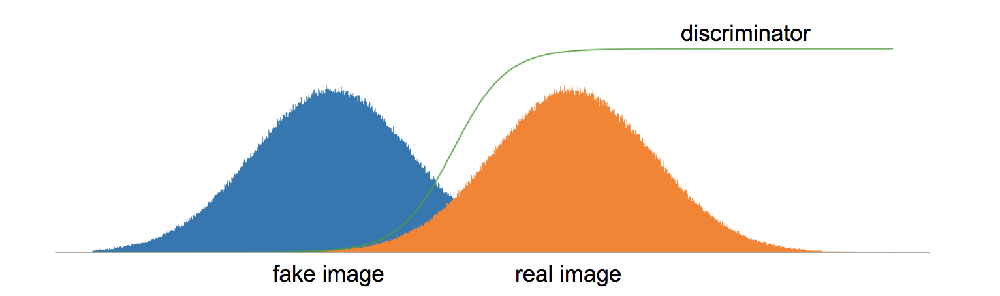

In [4]:
Image('./day8/gan.png')

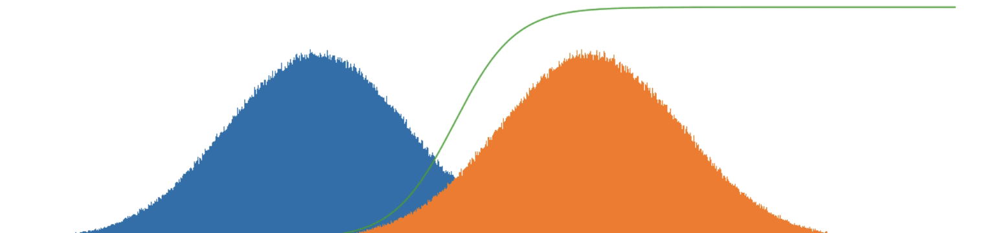

In [5]:
Image('./day8/gan_dist.gif.png')

#### Generator

 * 난수를 입력 받아 real image와 동일한 이미지(fake image)를 출력하는 Neural Network
 * Discriminator의 구분능력이 좋을 수록 Generator의 loss가 증가
 * 실제로 이 Generator를 학습 시켜서 이미지를 생성하는 모델을 만드는 것이 목표

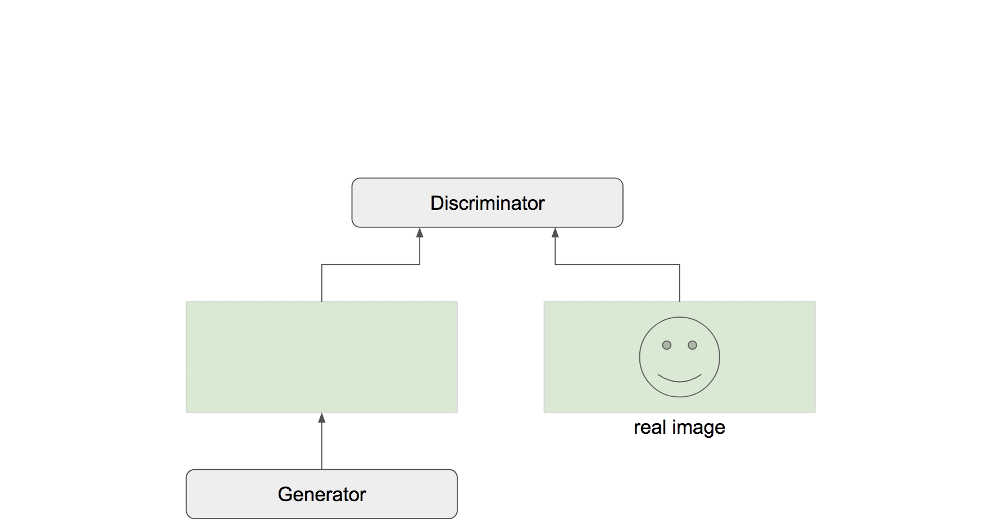

In [6]:
Image('./day8/generator_train.gif.png')

### Code Review

In [7]:
import tensorflow as tf
import numpy as np

tf.reset_default_graph()

def generator(z, reuse=False):
    name = 'generator/layer{}'
    layer1 = tf.layers.dense(z, 10, name=name.format(1), reuse=reuse)
    layer2 = tf.layers.dense(layer1, 10, name=name.format(2), reuse=reuse)
    layer3 = tf.layers.dense(layer2, 10, name=name.format(3), reuse=reuse)
    out = tf.layers.dense(layer3, 10, name=name.format('out'), reuse=reuse)
    return out

def discriminator(feature, reuse=False):
    name = 'discriminator/layer{}'
    layer1 = tf.layers.dense(feature, 10, name=name.format(1), reuse=reuse)
    layer2 = tf.layers.dense(layer1, 10, name=name.format(2), reuse=reuse)
    layer3 = tf.layers.dense(layer2, 10, name=name.format(3), reuse=reuse)
    layer4 = tf.layers.dense(layer3, 10, name=name.format(4), reuse=reuse)
    out = tf.layers.dense(layer4, 1, name=name.format('out'), reuse=reuse)
    return out
    
def gan_loss(logits_real, logits_fake):
    loss_real = tf.losses.sigmoid_cross_entropy(tf.ones_like(logits_real), logits_real)
    loss_fake = tf.losses.sigmoid_cross_entropy(tf.zeros_like(logits_fake), logits_fake)
    discriminator_loss = loss_real + loss_fake
    generator_loss = tf.losses.sigmoid_cross_entropy(tf.ones_like(logits_fake), logits_fake)
    return generator_loss, discriminator_loss

def train(loss, variables):
    optimizer = tf.train.GradientDescentOptimizer(0.01)
    grads = optimizer.compute_gradients(loss, var_list=variables)
    return optimizer.apply_gradients(grads)


data = [[i for i in range(10)] for _ in range(1000)]
normal = np.random.randn(1000, 10)

real_data = tf.placeholder(tf.float32, [None, 10])
z = tf.placeholder(tf.float32, [None, 10])

fake_data = generator(z)
disc_real_logits = discriminator(real_data, False)
disc_fake_logits = discriminator(fake_data, True)

disc_real_prob = tf.reduce_mean(tf.nn.sigmoid(disc_real_logits))
disc_fake_prob = tf.reduce_mean(tf.nn.sigmoid(disc_fake_logits))

loss_gen, loss_disc = gan_loss(disc_real_logits, disc_fake_logits)

variables = tf.trainable_variables()

gen_variables = [v for v in variables if v.name.startswith('generator')]
disc_variables = [v for v in variables if v.name.startswith('discriminator')]

print('variables in generator')
for v in gen_variables:
    print(v)

print('variables in discriminator')
for v in disc_variables:
    print(v)


disc_train_op = train(loss_disc, disc_variables)
gen_train_op = train(loss_gen, gen_variables)

with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for i in range(1000):
        _, _real_prob, _fake_prob = sess.run([disc_train_op, disc_real_prob, disc_fake_prob], 
                                             feed_dict={real_data: data, z: normal})
        _, _loss = sess.run([gen_train_op, loss_gen], feed_dict={z: normal})
        
        if i%100 == 0:
            print('step: {}, real prob: {}, fake prob: {}, loss: {}'.format(i, _real_prob, _fake_prob, _loss))
        
    _gen = sess.run(fake_data, feed_dict={z: normal})
    print('generating data')
    for g in _gen[:10]:
        print(g)

INFO:tensorflow:logits.dtype=<dtype: 'float32'>.
INFO:tensorflow:multi_class_labels.dtype=<dtype: 'float32'>.
INFO:tensorflow:losses.dtype=<dtype: 'float32'>.
INFO:tensorflow:logits.dtype=<dtype: 'float32'>.
INFO:tensorflow:multi_class_labels.dtype=<dtype: 'float32'>.
INFO:tensorflow:losses.dtype=<dtype: 'float32'>.
INFO:tensorflow:logits.dtype=<dtype: 'float32'>.
INFO:tensorflow:multi_class_labels.dtype=<dtype: 'float32'>.
INFO:tensorflow:losses.dtype=<dtype: 'float32'>.
variables in generator
<tf.Variable 'generator/layer1/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'generator/layer1/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'generator/layer2/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'generator/layer2/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'generator/layer3/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'generator/layer3/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'generator/layerout/kernel:0' shape=(10, 10) dtype=f

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

samples = 1000000
loc = 0.5
for i in range(7):
    dist1 = np.random.normal(loc=-i*loc, size=samples)
    dist2 = np.random.normal(loc=0, size=samples)
    x = np.arange(-6, 4, 0.01)
    
    sig_x = np.arange(-6, 4, 0.01)
    sig = 1.0/(1.+np.exp(-(float(i)*0.5*(sig_x+0.5*loc*float(i)))))*5000
    
    plt.figure(num=i, figsize=[20, 5])
    plt.hist(dist1, bins=x)
    plt.hist(dist2, bins=x)
    plt.plot(sig_x, sig)
    plt.savefig('./day8/gan{}'.format(i))
    plt.show()